<h1 style="color:#87CEEB; font-family:Arial; text-align:center;"> ANALYSE AND PREDICT CLIMATE CHANGES </h1>

<h2 style="color:blue; text-align:left;">Project Description :--</h2>

<h5 style="color: black; text-align: left;">
  Here we are analsying the climate of Rwanda. well we go into the analysis we know about the country, Rwanda is a landlocked country in the Great Rift Valley of East Africa, where the African Great Lakes region and Southeast Africa converge. 
Located a few degrees south of the Equator.
Rwanda with a distribution around farm lands, cities and power plants.
The years 2019 - 2021 data we have taken for analyze, and we have task to predict the CO2 emissions data for 2022 through November.</h5>

<h3 style="color:blue; text-align:left;">Discussing about the some terms on which Climate change is depended :</h3>

<h5 style="color: black; text-align: left;">we have taken the 
    
Density : Amount of gas in a vertical column of the atmosphere above a given area.

Density_Amf : Air Mass Factor (AMF) is a correction factor that relates the amount of gas actually measured by a satellite (slant column) to the amount that would be directly above a point on the ground (vertical column).

Slant Column : The slant column refers to the total amount of a gas measured along the path from the satellite to the Earth’s surface (which is at an angle, not straight down).

Vertical Column=(Slant Column/AMF)

cloud_fraction : cloud_fraction is a value between 0 and 1 that indicates how much of the sky is covered by clouds in a specific area.

0 → Clear sky (no clouds)
1 → Fully overcast (100% cloud cover)

azimuth_angle : The azimuth_angle describes the compass direction from which the sunlight or satellite sensor is viewing a point on Earth.

sensor_zenith_angle : The zenith_angle is the angle between:Directly overhead (the zenith, 0°) And the incoming light (from the Sun or satellite sensor)

solar_zenith_angle : The solar_zenith_angle is the angle between the Sun and the vertical direction (zenith) at a specific location.

0° → Sun is directly overhead

90° → Sun is on the horizon (sunrise/sunset)

lessthan 90° → Sun is below the horizon (nighttime)

Ozone  : Ozone is a gas made of three oxygen atoms (O₃)

Cloud : Clouds are made of tiny water droplets or ice crystals suspended in the atmosphere. They form when moist air rises and cools, condensing water vapor.

UV Aerosol Index :The UV Aerosol Index (UVAI) is a satellite-derived measure that detects UV-absorbing aerosols (smoke,dust,ash)
</h5>


In [1]:
## import files and libraries
## Data collection process
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
train = pd.read_csv("climate change data.csv")

In [2]:
train.to_csv('climate change data.csv')

In [3]:
## Data cleaning process
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57209 entries, 0 to 57208
Data columns (total 70 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Unnamed: 0                                   57209 non-null  int64  
 1   ID LAT LON YEAR WEEK                         57209 non-null  object 
 2   latitude                                     57209 non-null  float64
 3   longitude                                    57209 non-null  float64
 4   year                                         57209 non-null  int64  
 5   week no                                      57209 non-null  int64  
 6   SO2 density                                  57209 non-null  float64
 7   SO2 density amf                              57209 non-null  float64
 8   SO2 slant density                            57209 non-null  float64
 9   SO2 cloud fraction                           57209 non-null  float64
 10

In [4]:
## Remove NAN from data
train =train.dropna()

In [5]:
train.shape

(57209, 70)

In [6]:
desc =train.describe()

In [7]:
desc.to_csv('describe_info.csv')

In [8]:
print(train['longitude'].nunique())
print(train['latitude'].nunique())

450
449


In [9]:
import folium

# Create base map centered around the mean location
map_center = [train['latitude'].mean(), train['longitude'].mean()]
dot_map = folium.Map(location=map_center, zoom_start=6)

# Add dots
for _, row in train.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.7
    ).add_to(dot_map)

# Show the map
dot_map


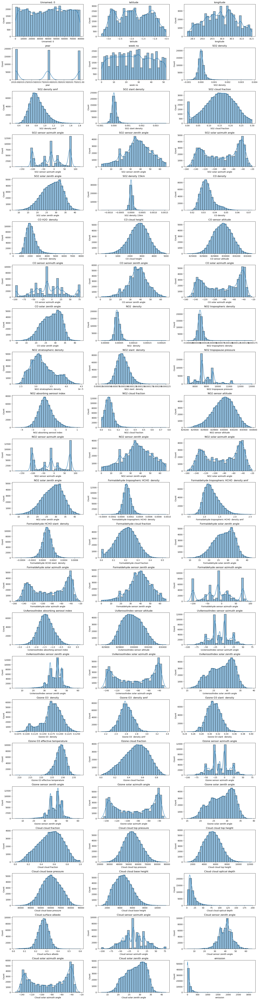

In [10]:
numeric_cols = train.select_dtypes(include='number').columns
n = len(numeric_cols)
cols = 3
rows = int(np.ceil(n / cols))

fig, axes = plt.subplots(rows, cols, figsize=(18, rows * 3))

for i, col in enumerate(numeric_cols):
    ax = axes[i // cols, i % cols]
    sns.histplot(train[col], kde=True, ax=ax, bins=30)
    ax.set_title(col)

# Hide empty subplots
for j in range(i + 1, rows * cols):
    fig.delaxes(axes[j // cols, j % cols])

plt.tight_layout()
plt.savefig('distribution.png')
plt.show()

<h2> From the above graph i have we can clearly say that reacording are taken in different daytimings 

1.Recording taken from the Azimuth angle(sun position to object) are almost Day and night or twilight timings. the angle is frenquency distributed 

2.Recording taken from the zenith angle(sun rays project on object ) are mostly taken on day timings.The reading angles are normaly distrubted.


<h3>Here we are taking data, where AMF and Slaint density are calculated and final density we get

Vertical Column Density (VCD) = Slant Column Density / AMF

</h3>

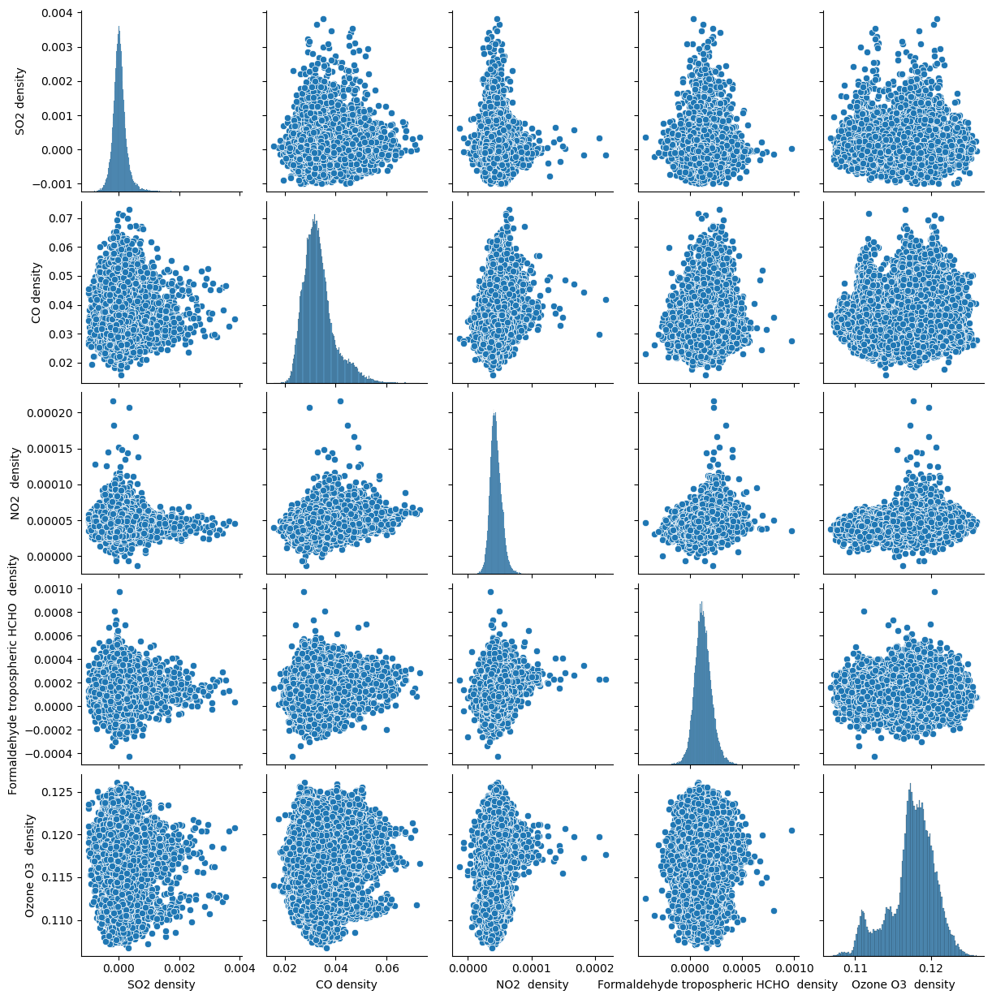

In [11]:
## relation between densities


plot = sns.pairplot(train[['SO2 density','CO density','NO2  density','Formaldehyde tropospheric HCHO  density','Ozone O3  density']])

plot.fig.savefig("plot.jpeg")

<h5 style="color:blue; text-align:left;"> We know that 
    
---> Weak Positive Relationships: SO2 shows a weak positive correlation with all other variables.
    
---> Moderate Positive Relationships: CO, NO2, and HCHO show moderate positive correlations with each other and with O3.

---> O3 as a Central Variable: Ozone (O3) density tends to increase as CO, NO2, and HCHO densities increase.</h5>

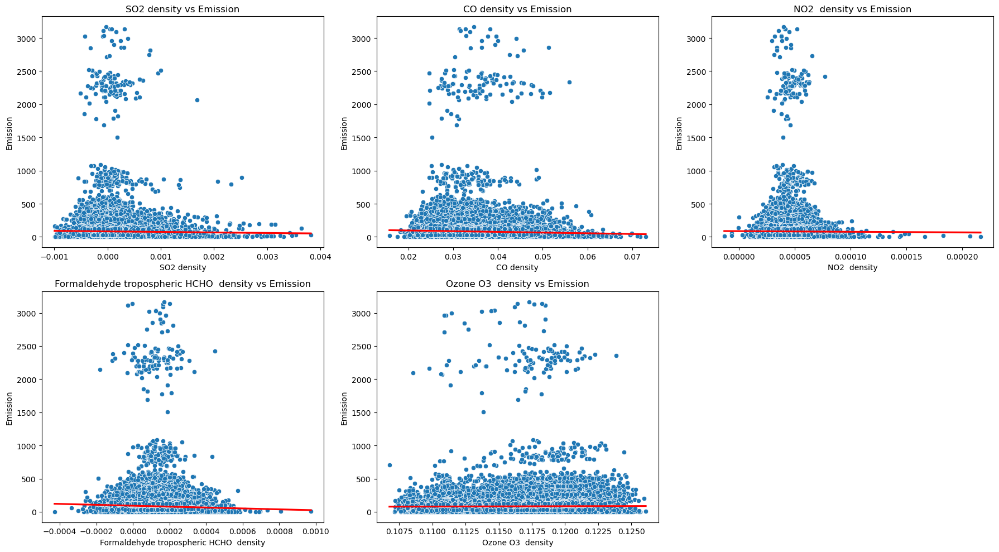

In [12]:
densities = [
    'SO2 density',
    'CO density',
    'NO2  density',
    'Formaldehyde tropospheric HCHO  density',
    'Ozone O3  density']


fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
axes = axes.flatten()

# Plot each subplot
for i, gas in enumerate(densities):
    sns.scatterplot(data=train, x=gas, y='emission', ax=axes[i])
    sns.regplot(data=train, x=gas, y='emission', scatter=False, ax=axes[i], color='red')
    axes[i].set_title(f'{gas} vs Emission')
    axes[i].set_xlabel(gas)
    axes[i].set_ylabel('Emission')

# Remove unused subplot if any
if len(densities) < len(axes):
    for j in range(len(densities), len(axes)):
        fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig("densities_vs_emission_subplot.png", dpi=300)
plt.show()

<h5 style="color:blue; text-align:left;"> 
    we can only interpret the patterns in the data.
    
--->CO and NO2 are the strongest predictors: CO and NO2 densities show the strongest positive relationships with "Emission," suggesting they might be more influential factors.

--->SO2, HCHO, and O3 have weak relationships: SO2, HCHO, and O3 densities have weak positive relationships with "Emission," 
 indicating they might not be strongly associated with the emission process being measured.

---> need to be more analysis

<h4> Reading taken in different areas how many area reaings has taken and each area increases more co2 emission</h4>

In [13]:
Weekwise = train.groupby(['year','week no'])['emission'].mean().reset_index()

In [14]:
Weekwise

,year,week no,emission
0,2019,0,64.415420
1,2019,1,82.998669
2,2019,2,82.105929
3,2019,3,91.057897
4,2019,4,92.981316
...,...,...,...
153,2021,48,86.449145
154,2021,49,70.184358
155,2021,50,82.500927
156,2021,51,71.679088


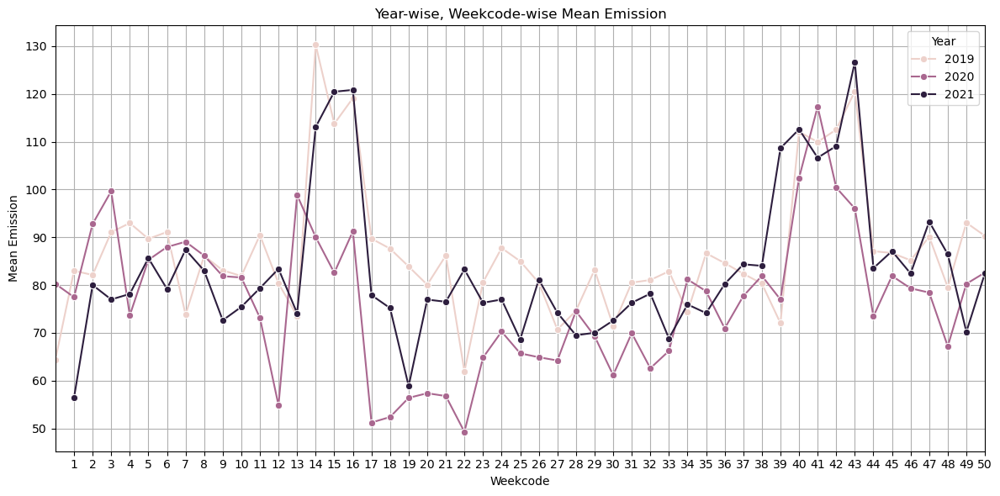

In [15]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=Weekwise, x='week no', y='emission', hue='year', marker='o')
plt.title("Year-wise, Weekcode-wise Mean Emission")
plt.xlabel("Weekcode")
plt.xlim(0,50)
plt.xticks(ticks=range(1, 51))
plt.ylabel("Mean Emission")
plt.legend(title='Year')
plt.grid(True)
plt.tight_layout()
plt.savefig("Trend chart.png")
plt.show()

<h3>There is a clear seasonal and event-based emission pattern. Year 2020 stands out with a significant drop during mid-year, indicating the impact of the pandemic. Peaks during Weeks 14–16 and 40–44 are consistent, indicating possible recurring high-emission activities.</h3>

MODEL

In [16]:
col1 =['SO2 sensor azimuth angle','SO2 solar azimuth angle','CO sensor azimuth angle','CO solar azimuth angle','NO2 sensor azimuth angle'
      ,'NO2 solar azimuth angle','Formaldehyde solar azimuth angle','Formaldehyde sensor azimuth angle'
      ,'Ozone sensor azimuth angle','Ozone solar azimuth angle','Cloud sensor azimuth angle',
      'Cloud solar azimuth angle','emission']
col2 =['SO2 sensor zenith angle','SO2 solar zenith angle','CO sensor zenith angle','CO solar zenith angle','NO2 sensor zenith angle',
       'NO2 solar zenith angle','Formaldehyde solar zenith angle','Ozone sensor zenith angle',
       'Ozone solar zenith angle','Cloud sensor zenith angle','Cloud solar zenith angle','emission']
corr1 = train[col1].corr()

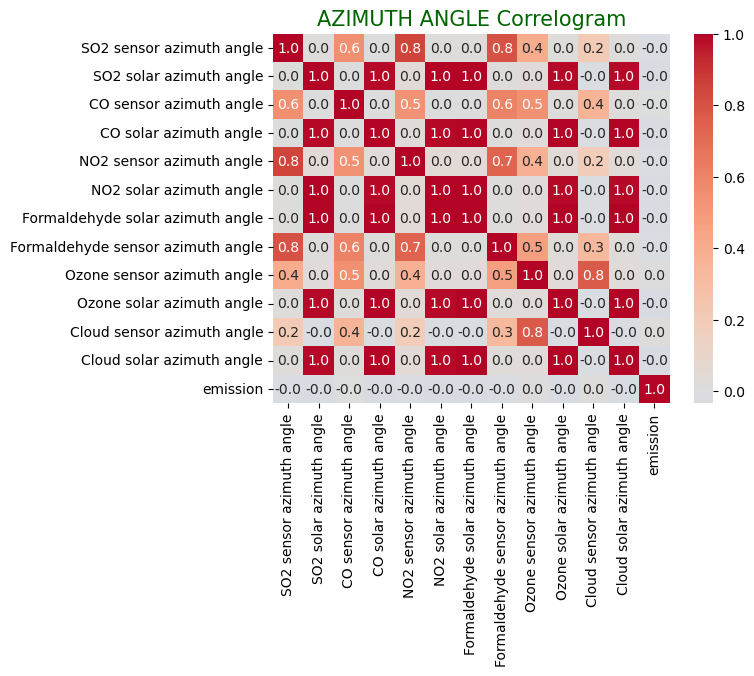

In [17]:
sns.heatmap(corr1, cmap='coolwarm', annot = True, fmt=".1f",center = 0)
plt.title('AZIMUTH ANGLE Correlogram', fontsize = 15, color = 'darkgreen')
plt.savefig("Azimuth Angle Correlogram.jpeg")
plt.show()

<h3> Here all solar azimuth angles are related (appox 1 correlation) each other,

</h3>

In [18]:
corr2 = train[col2].corr()

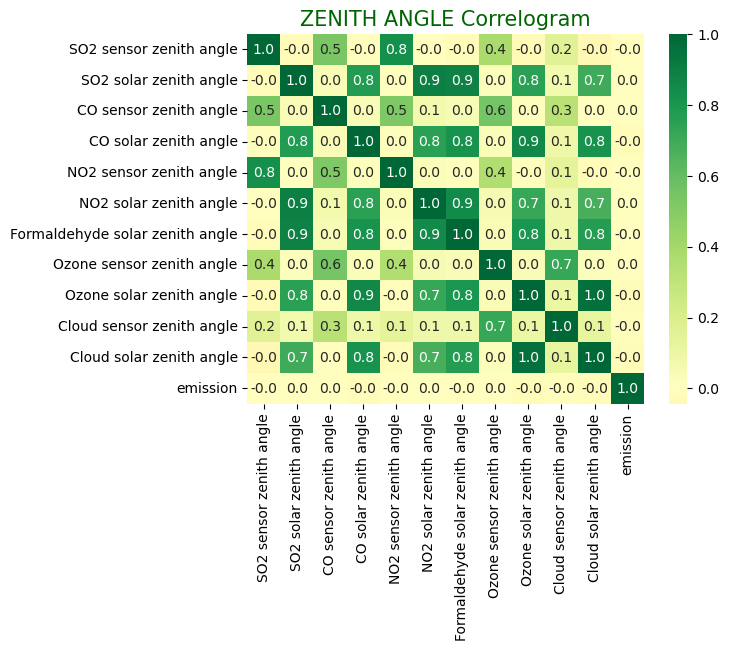

In [19]:
sns.heatmap(corr2, cmap='RdYlGn', annot = True,fmt=".1f", center = 0)
plt.title('ZENITH ANGLE Correlogram', fontsize = 15, color = 'darkgreen')
plt.savefig("Zenith Angle Correlogram")
plt.show()

<h4>
CO sensor zenith angle and Ozone sensor zenith angle has 0.6 cor.

CO solar ↔ Ozone solar has 0.9.

other parameter futures are strongly correlated with each other so we can remove them.
</h4>

<h4> Removing the Angle feature which is less importance in predicting the emission, but mostly related to the  Density of each Gas parameter, Here we are removing the angles from data for elimating noise in data </h4>

In [20]:
features_to_drop = ['SO2 solar zenith angle','CO solar zenith angle','NO2 solar zenith angle','Formaldehyde solar zenith angle',
                    'Ozone solar zenith angle','Cloud solar zenith angle','SO2 sensor azimuth angle','CO sensor azimuth angle',
                    'NO2 sensor azimuth angle','Formaldehyde sensor azimuth angle','Ozone sensor azimuth angle',
                    'Cloud sensor azimuth angle','ID LAT LON YEAR WEEK','year','week no']


cleaned_train = train.drop(features_to_drop,axis=1)

In [21]:
cleaned_train.head()

,Unnamed: 0,latitude,longitude,SO2 density,SO2 density amf,SO2 slant density,SO2 cloud fraction,SO2 sensor zenith angle,SO2 solar azimuth angle,SO2 density 15km,...,Cloud cloud fraction,Cloud cloud top pressure,Cloud cloud top height,Cloud cloud base pressure,Cloud cloud base height,Cloud cloud optical depth,Cloud surface albedo,Cloud sensor zenith angle,Cloud solar azimuth angle,emission
0,1,-0.51,29.29,0.000021,0.728214,0.000014,0.130988,39.137194,-140.874435,0.000012,...,0.213608,63790.29624,3651.190311,66969.47873,3174.572424,8.690601,0.256830,39.557633,-145.183930,4.025176
1,2,-0.51,29.29,0.000514,0.748199,0.000385,0.110018,52.868816,-150.191757,0.000154,...,0.703540,55923.79055,4216.986492,60068.89445,3516.282669,21.103410,0.251101,30.401823,-142.519545,4.231381
2,4,-0.51,29.29,-0.000079,0.676296,-0.000048,0.121164,35.515587,-137.409159,-0.000028,...,0.189336,59904.31484,3980.598120,63751.12578,3355.710107,8.114694,0.235847,37.392979,-141.509805,4.347317
3,5,-0.51,29.29,0.000294,0.871713,0.000242,0.227656,57.097124,-136.616859,0.000076,...,0.450184,43494.92174,5530.354546,49846.00101,4495.301362,7.556143,0.250228,37.007020,-137.388719,4.310819
4,6,-0.51,29.29,-0.000285,0.791956,-0.000226,0.119397,58.496368,-143.726913,-0.000088,...,0.524988,53483.78398,4378.614648,58804.27656,3537.050659,10.493107,0.240828,30.491541,-128.196338,4.269334


In [22]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

In [23]:
x = cleaned_train.drop(['emission'],axis=1)
y =cleaned_train['emission']

In [34]:
if 'Unnamed: 0' in x.columns:
    x = x.drop(columns=['Unnamed: 0'])

In [35]:
x_train,x_test,y_train,y_test =train_test_split(x,y, random_state= 43,test_size =0.2)

In [36]:
model = RandomForestRegressor(random_state=42)

In [37]:
model.fit(x_train, y_train)

RandomForestRegressor(random_state=42)

In [38]:
import pickle
with open('model.pkl', 'wb') as f:
    pickle.dump(model, f)


In [39]:
y_pred = model.predict(x_test)

In [40]:
from sklearn.metrics import mean_squared_error, r2_score
print("R² Score:", r2_score(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))

R² Score: 0.9379918427237676
MSE: 1350.3968644999889


<h3 style="color:red; text-align:left;">Conclusion:</h3>
<h3 style="color:blue; text-align:left;">In this project, we analyzed and modeled environmental emission data using various sensor and solar angle parameters. After performing thorough preprocessing—such as handling missing values, analyzing correlations, and exploring trends—we selected the Random Forest Regressor for prediction modeling.
<br>
<br> 
The model demonstrated exceptionally high performance, achieving:<br>
R² Score: 0.9379<br>
Mean Squared Error (MSE): 1350.39</h3>
